# Vignette: Generating Synthetic Images for Training Your Classifier

In [2]:
from synderm.generation.generate import generate_synthetic_dataset
from synderm.fine_tune.text_to_image_diffusion import fine_tune_text_to_image
from synderm.utils.utils import synthetic_train_val_split

from sklearn.metrics import classification_report
from fastai.vision.all import *
from torchvision import transforms
from torch.utils.data import Dataset
from IPython.display import display
from collections import Counter
from PIL import Image
from pathlib import Path
import os

In [6]:
# Set path to root directory of package
%cd ../../../

/workspace/synthetic-derm


/workspace/synthetic-derm/.venv/lib/python3.10/site-packages/IPython/core/magics/osm.py:417: UserWarning: This is now an optional IPython functionality, setting dhist requires you to install the `pickleshare` library.
  self.shell.db['dhist'] = compress_dhist(dhist)[-100:]


### Introduction
This notebook will walk you through the entire process of augmenting a classifier with synthetic images. For simplicity, we will use a preloaded sample dataset containing 10 classes from Imagenet (Imagenette2). We have purposely subset this dataset to include 200 images for each class in the training data, but only 20 images for the English Springer class. We will demonstrate how to train a diffusion model and generate synthetic images to train an image classification model. 

This notebook is intended to demonstrate how the Synderm package can be used to generate high-quality synthetic images for your dataset. It is not intended to be an impressive benchmark on Imagenet, this is just a standin for your data.

In [7]:
# Set the experiment directory -- change this to your experiment directory
#EXPERIMENT_DIR = "/n/scratch/users/t/thb286/dog_experiment"
EXPERIMENT_DIR = "/workspace/dog_experiment"

### 1. Creating the dataset
The first step is the create a Pytorch dataset. Example datasets are listed in `sample_datasets.py`. For this example, we will use a simplified dataset that contains 10 classes. This dataset is included at `/imagenette2_subset`. 

For datasets to work with methods in this package, each entry must contain an `image` field returning a PIL Image, a `label` field with the label, and an `id` field containing a unique ID for each image.

In [8]:
class SampleDataset(Dataset):
    def __init__(self, dataset_dir, split="train"):
        self.dataset_dir = Path(dataset_dir)
        self.image_paths = []
        self.labels = []
        self.split = split

        # Walk through class folders
        data_dir = self.dataset_dir / self.split
        for class_name in os.listdir(data_dir):
            class_dir = data_dir / class_name
            if not class_dir.is_dir():
                continue
                
            # Get all png images in this class folder
            for img_name in os.listdir(class_dir):
                if img_name.lower().endswith('.jpeg'):
                    self.image_paths.append(class_dir / img_name)
                    self.labels.append(class_name)

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image_path = self.image_paths[idx]
        label = self.labels[idx]
        
        # Load and convert image to RGB
        image = Image.open(image_path).convert('RGB')
        image_name = image_path.stem

        return {"id": image_name, "image": image, "label": label}

In [9]:
train_dataset = SampleDataset(dataset_dir="imagenette2_subset", split="train")
test_dataset = SampleDataset(dataset_dir="imagenette2_subset", split="val")

In [10]:
train_dataset[0]

{'id': 'ILSVRC2012_val_00000665',
 'image': <PIL.Image.Image image mode=RGB size=500x334>,
 'label': 'English_springer'}

In [11]:
print("Label distribution in training dataset:")
label_counts = {}
for item in train_dataset:
    label = item['label']
    label_counts[label] = label_counts.get(label, 0) + 1
print("\n".join(f"{label}: {count}" for label, count in label_counts.items()))


Label distribution in training dataset:


English_springer: 20
French_horn: 200
cassette_player: 200
chain_saw: 200
church: 200
garbage_truck: 200
gas_pump: 200
golf_ball: 200
parachute: 200
tench: 200


### 2. Train the synthetic image generator
Now that we have a dataset, we will train a diffusion model using Dreambooth on our training set of images. This will result in generating images more similar to our training data.

In [15]:
output_dir = os.path.join(EXPERIMENT_DIR, "dreambooth-outputs")

fine_tune_text_to_image(
    train_dataset= train_dataset,
    output_dir = output_dir,
    pretrained_model_name_or_path = "stabilityai/stable-diffusion-2-1-base",
    instance_prompt = "An image of an English Springer",  
    validation_prompt_format = "An image of an English Springer",
    label_filter = "English_springer",
    resolution = 512,
    train_batch_size = 4,
    gradient_accumulation_steps = 1,
    learning_rate = 5e-6,
    lr_scheduler = "constant",
    lr_warmup_steps = 0,
    num_train_epochs = 12,
    report_to = "wandb",
    validation_steps = 20,
    verbose=False
)

07/15/2025 15:25:48 - INFO - synderm.fine_tune.text_to_image_diffusion - Starting training for label: English_springer
07/15/2025 15:25:48 - INFO - synderm.fine_tune.text_to_image_diffusion - The length of the training dataset for label 'English_springer' is: 20
wandb: Using wandb-core as the SDK backend.  Please refer to https://wandb.me/wandb-core for more information.
wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:wandb: Appending key for api.wandb.

07/15/2025 15:31:53 - INFO - synderm.fine_tune.text_to_image_diffusion - running validation... 
 generating 8 images with prompt: An image of an English Springer.
Loading pipeline components...: 100%|██████████| 6/6 [00:00<00:00, 328.40it/s]
07/15/2025 15:32:03 - INFO - synderm.fine_tune.text_to_image_diffusion - Validation at epoch 0 completed for label 'English_springer'. Generated 8 images.
07/15/2025 15:32:03 - INFO - synderm.fine_tune.text_to_image_diffusion - ***** Running training *****
07/15/2025 15:32:03 - INFO - synderm.fine_tune.text_to_image_diffusion -   Label = English_springer
07/15/2025 15:32:03 - INFO - synderm.fine_tune.text_to_image_diffusion -   Num examples = 20
07/15/2025 15:32:03 - INFO - synderm.fine_tune.text_to_image_diffusion -   Num batches each epoch = 5
07/15/2025 15:32:03 - INFO - synderm.fine_tune.text_to_image_diffusion -   Num Epochs = 12
07/15/2025 15:32:03 - INFO - synderm.fine_tune.text_to_image_diffusion -   Instantaneous batch size per device = 4


loss,▄▂▁▅▂▂▄▂▂▂▂▃▂▃▃▄▁▆▂▃▆▄▄▂▁▃▂▃▃▂▂▄▄▅█▄▅▄▃▂
lr,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
loss,0.10037
lr,1e-05


/workspace/synthetic-derm/.venv/lib/python3.10/site-packages/wandb/sdk/wandb_run.py:2368: UserWarning: Run (olgenla9) is finished. The call to `_console_raw_callback` will be ignored. Please make sure that you are using an active run.
  lambda data: self._console_raw_callback("stderr", data),
Steps: 100%|██████████| 60/60 [01:23<00:00,  1.40s/it, loss=0.1, lr=5e-6]


### 3. Generate synthetic images
We have trained a model to generate synthetic images. We now need to use this model to generate a lot of synthetic images.

In [16]:
model_path = os.path.join(EXPERIMENT_DIR, "dreambooth-outputs", "English_springer")
image_output_path = os.path.join(EXPERIMENT_DIR, "generations")

generate_synthetic_dataset(
    dataset= train_dataset,
    model_path = model_path,
    output_dir_path = image_output_path,
    generation_type = "text-to-image", 
    label_filter = "English_springer",
    instance_prompt = "An image of an English Springer",
    batch_size = 16,
    start_index = 0,
    num_generations_per_image = 10,
    guidance_scale = 3.0,
    num_inference_steps = 50,
    strength_inpaint = 0.970,
    strength_outpaint = 0.950,
    mask_fraction = 0.25
)

Loading model


Loading pipeline components...: 100%|██████████| 5/5 [00:02<00:00,  1.95it/s]


Loaded pipeline with 865_910_724 unet parameters


/workspace/synthetic-derm/.venv/lib/python3.10/site-packages/rich/live.py:231: UserWarning: install "ipywidgets" 
for Jupyter support
  warnings.warn('install "ipywidgets" for Jupyter support')

/workspace/synthetic-derm/synderm/generation/generate.py:218: TqdmExperimentalWarning: rich is experimental/alpha
  for idx in tqdm(range(start_index, start_index + num_generations_per_image)):


[Repeat 0, batch 0] Saved image grid to /workspace/dog_experiment/generations/grid/00-batch-00.png

[Repeat 1, batch 0] Saved image grid to /workspace/dog_experiment/generations/grid/01-batch-00.png

[Repeat 2, batch 0] Saved image grid to /workspace/dog_experiment/generations/grid/02-batch-00.png

[Repeat 3, batch 0] Saved image grid to /workspace/dog_experiment/generations/grid/03-batch-00.png

[Repeat 4, batch 0] Saved image grid to /workspace/dog_experiment/generations/grid/04-batch-00.png

[Repeat 5, batch 0] Saved image grid to /workspace/dog_experiment/generations/grid/05-batch-00.png

[Repeat 6, batch 0] Saved image grid to /workspace/dog_experiment/generations/grid/06-batch-00.png

[Repeat 7, batch 0] Saved image grid to /workspace/dog_experiment/generations/grid/07-batch-00.png

[Repeat 8, batch 0] Saved image grid to /workspace/dog_experiment/generations/grid/08-batch-00.png

[Repeat 9, batch 0] Saved image grid to /workspace/dog_experiment/generations/grid/09-batch-00.png

Preview some of the images generated by the fine-tuned model (top row are newly is generated, bottom row are original)

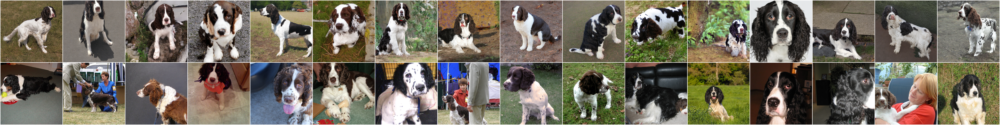

In [17]:
img = Image.open(os.path.join(image_output_path, "grid/00-batch-00.png"))
display(img)

### 4. Training the classifier
We now have a directory of synthetic images. We need to train a classifier using our real training data, as well as these synthetic images.

We will first create a new Torch Dataset to load the synthetically generated images. These will be present in multiple folders (00, 01, ..., 10) indicating the generation number.

In [18]:
class SyntheticDataset(Dataset):
    def __init__(self, dataset_dir):
        self.dataset_dir = Path(dataset_dir)
        self.image_paths = []
        self.labels = []

        # Walk through class folders
        for num in range(0, 10):
            split = f"{num:02d}"

            data_dir = self.dataset_dir / split
            for class_name in os.listdir(data_dir):
                class_dir = data_dir / class_name
                if not class_dir.is_dir():
                    continue
                    
                # Get all png images in this class folder
                for img_name in os.listdir(class_dir):
                    if img_name.lower().endswith('.png'):
                        self.image_paths.append(class_dir / img_name)
                        self.labels.append(class_name)

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image_path = self.image_paths[idx]
        label = self.labels[idx]
        
        # Load and convert image to RGB
        image = Image.open(image_path).convert('RGB')
        image_name = image_path.stem

        return {"id": image_name, "image": image, "label": label}

In [19]:
synthetic_dataset = SyntheticDataset(os.path.join(image_output_path, "text-to-image"))

Now we will use the synthetic_train_val_split function to generate a training dataset that includes both real and synthetic images, and a validation set that only includes real images.

In [20]:
train, val = synthetic_train_val_split(
    real_data=train_dataset,
    synthetic_data=synthetic_dataset,
    per_class_test_size=5,
    random_state=42,
    mapping_real_to_synthetic="id"
)

In [21]:
# Print first entries to inspect the training dataset
for i in range(3):
    print(f"Sample {i}:", train[i])

Sample 0: {'id': 'ILSVRC2012_val_00001968', 'image': <PIL.Image.Image image mode=RGB size=500x334>, 'label': 'English_springer'}
Sample 1: {'id': 'ILSVRC2012_val_00002294', 'image': <PIL.Image.Image image mode=RGB size=500x375>, 'label': 'English_springer'}
Sample 2: {'id': 'ILSVRC2012_val_00004548', 'image': <PIL.Image.Image image mode=RGB size=500x375>, 'label': 'English_springer'}


In [22]:
labels = [sample['label'] for sample in train]
label_counts = Counter(labels)

print("Label distribution in training dataset:")
print("\n".join(f"{label}: {count}" for label, count in label_counts.items()))

Label distribution in training dataset:
English_springer: 165
French_horn: 195
cassette_player: 195
chain_saw: 195
church: 195
garbage_truck: 195
gas_pump: 195
golf_ball: 195
parachute: 195
tench: 195


With these datasets, any image classification pipeline can now be used. Since we use Pytorch Datasets, a Pytorch system will be easiest to implement. We demonstrate how to use the training and validation sets to train and evaluate a model using the `fastai` library.

We need to use a custom collate_fn to make our datasets work with fastai DataLoaders.

In [23]:
unique_labels = sorted(set(labels))
label_to_idx = {label: i for i, label in enumerate(unique_labels)}

def collate_fn(batch):
    tfms = transforms.Compose([
        transforms.Resize((224, 224)),  # Ensure all images have same size
        transforms.ToTensor(),
    ])

    images, labels = [], []

    for sample in batch:
        img = tfms(sample['image'])
        lbl = label_to_idx[sample['label']]
        images.append(img)
        labels.append(lbl)

    images = torch.stack(images, dim=0)
    labels = torch.tensor(labels)

    return images, labels

train_loader = torch.utils.data.DataLoader(train, shuffle=True, batch_size=32, collate_fn=collate_fn)
val_loader = torch.utils.data.DataLoader(val, shuffle=False, batch_size=32, collate_fn=collate_fn)

In [24]:
import fastai

# Wrap the PyTorch DataLoaders in fastai's DataLoaders class for fastai training
dls = fastai.data.core.DataLoaders(train_loader, val_loader)
from fastai.vision.all import *
import torch.nn.functional as F

num_classes = len(label_to_idx)
model = create_vision_model(arch=efficientnet_v2_m, pretrained=True, n_out=num_classes)

learn = Learner(dls, 
                model, 
                loss_func=F.cross_entropy, 
                metrics=[error_rate, accuracy], 
                cbs=[EarlyStoppingCallback(monitor='valid_loss', patience=3)])

learn.fit(5)

/workspace/synthetic-derm/.venv/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/workspace/synthetic-derm/.venv/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=EfficientNet_V2_M_Weights.IMAGENET1K_V1`. You can also use `weights=EfficientNet_V2_M_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.979123,1.032318,0.220000,0.780000,00:33
1,0.902130,0.488050,0.120000,0.880000,00:33
2,0.837985,45.046600,0.460000,0.540000,00:33
3,0.689953,0.694595,0.240000,0.760000,00:32
4,0.784192,1.033568,0.340000,0.660000,00:32


No improvement since epoch 1: early stopping


Now that we have trained the classifier, we can evaluate the model on the held-out test dataset.

In [25]:
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=32, shuffle=False, collate_fn=collate_fn)

test_preds, test_targets = learn.get_preds(dl=test_loader)

test_accuracy = (test_preds.argmax(dim=1) == test_targets).float().mean()
print(f"Test accuracy: {test_accuracy:.4f}")

pred_classes = test_preds.argmax(dim=1).numpy()
true_classes = test_targets.numpy()

idx_to_label = {v: k for k, v in label_to_idx.items()}

report = classification_report(
    true_classes, 
    pred_classes,
    target_names=[idx_to_label[i] for i in range(num_classes)],
    digits=4
)
print("\nDetailed Classification Report:")
print(report)


Test accuracy: 0.6683

Detailed Classification Report:
                  precision    recall  f1-score   support

English_springer     0.9211    0.6203    0.7413       395
     French_horn     0.3265    0.9365    0.4843       394
 cassette_player     0.5590    0.6106    0.5837       357
       chain_saw     0.7211    0.5492    0.6235       386
          church     0.8344    0.6650    0.7401       409
   garbage_truck     0.9180    0.7198    0.8069       389
        gas_pump     0.8238    0.4129    0.5501       419
       golf_ball     0.7314    0.7644    0.7475       399
       parachute     0.9309    0.6564    0.7699       390
           tench     0.9391    0.7571    0.8383       387

        accuracy                         0.6683      3925
       macro avg     0.7705    0.6692    0.6886      3925
    weighted avg     0.7725    0.6683    0.6886      3925



### Conclusion

Considering most of our English springer training images are synthetically generated, this performance is good! Of course, this is only an example, and you should substitute this dataset for your own. 

See the next example, `train_fitz_classifier2.ipynb` for an applied example of the gains in performance that can be achieved by generating synthetic dermatology examples.